<a href="https://colab.research.google.com/github/nusfeiwei/RPassignment/blob/main/work1map.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Write a program in python to implement the MAP (or regularization) for polynomial curve fitting problem. Follow the instructions below:

1. Generate 50 2D-data points using the following function: 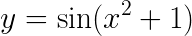
2. Add Gaussian random noise to the data
3. Show the original curve line and the noisy data.
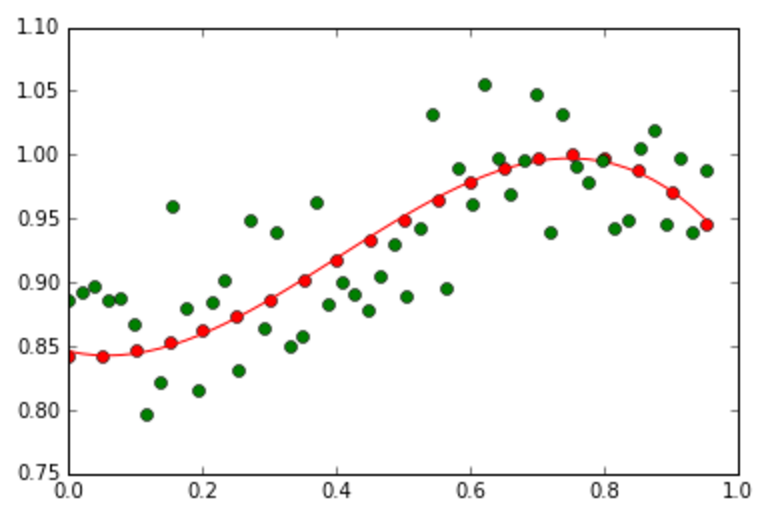
The red line is the original curve based on the equation. The green dots are the noisy data.
4. Fit the generated noisy data using the MAP as discussed in class.
5. Compute and display the total absolute error value (between the predicted and the correct ones) of using the computed w.
6. Display the estimated values of w
7. Experiment with your code by changing M and alpha (the coefficient of the regularization/prior term) to various values, and then show the plots. On each the plot, you must show the values of M and alpha.  
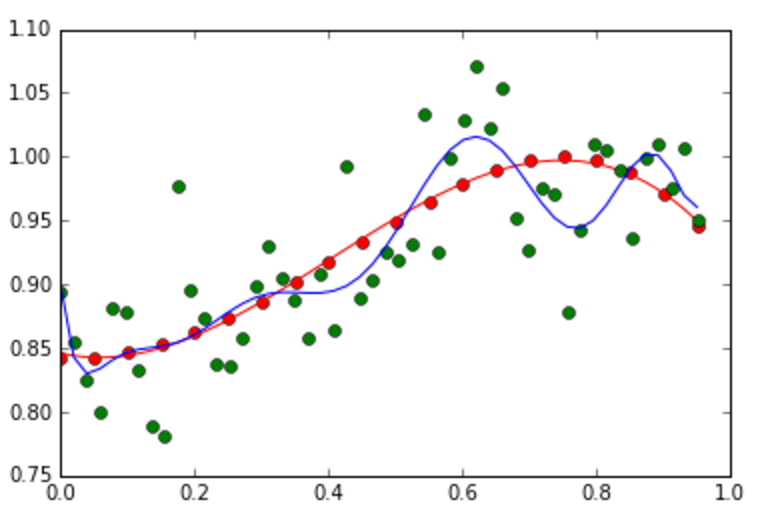
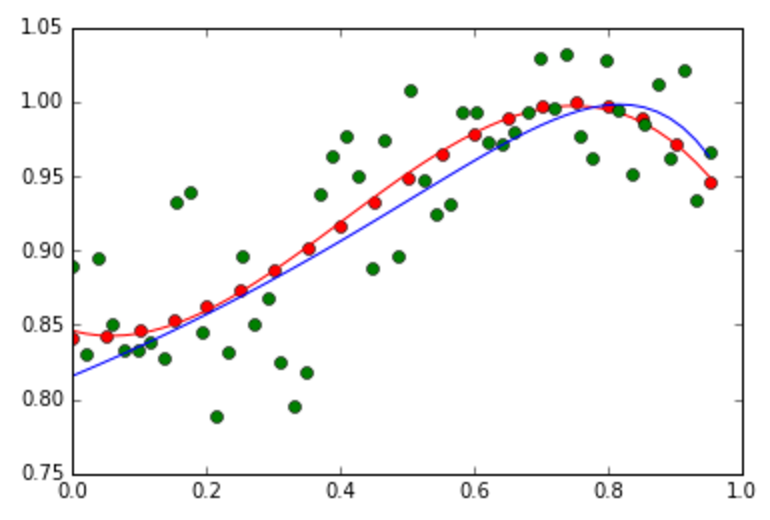

Left: An example of the overfitting problem when M = 10. Right: An example of how the regularization term reduces the overfitting problem (M =10, alpha = 0.4).
8. From the experiment in #7, discuss how M and alpha influence on the fitting accuracy.

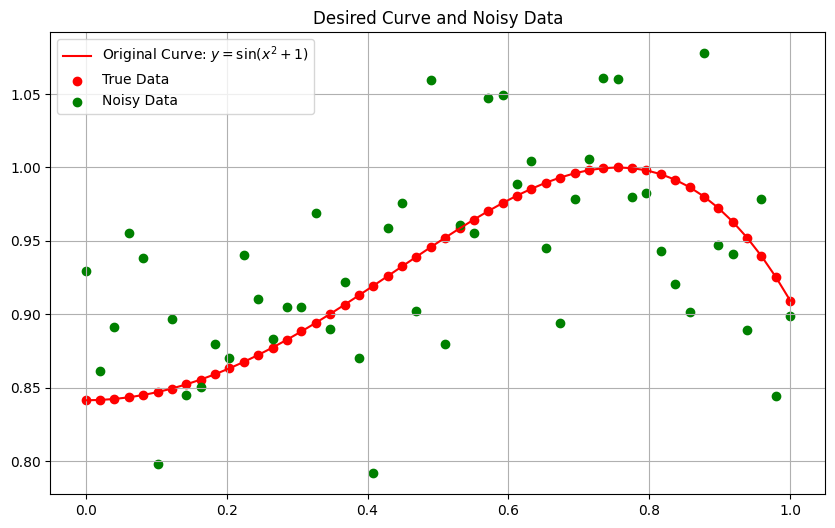

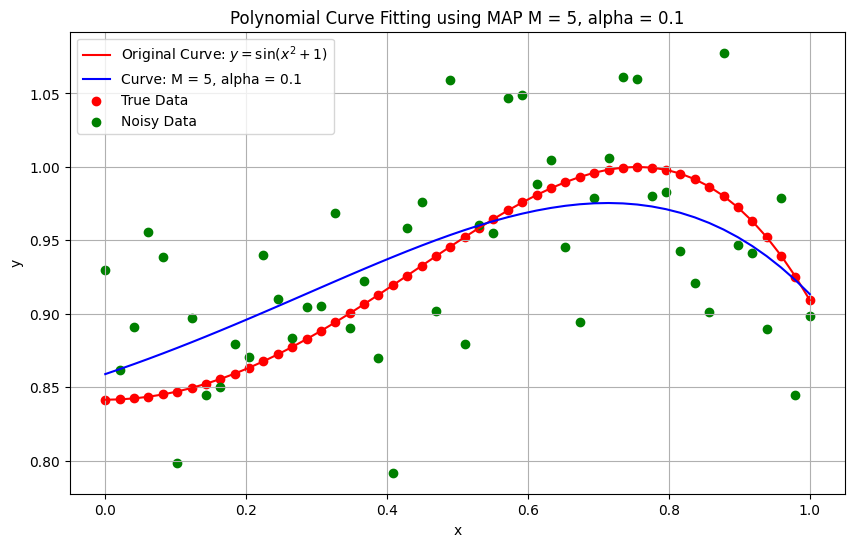

total absolute error value =  1.02559714369138
 w =  [ 0.85891752  0.16192819  0.13058164 -0.03664318 -0.20142782] 
 M =  5 alpha =  0.1


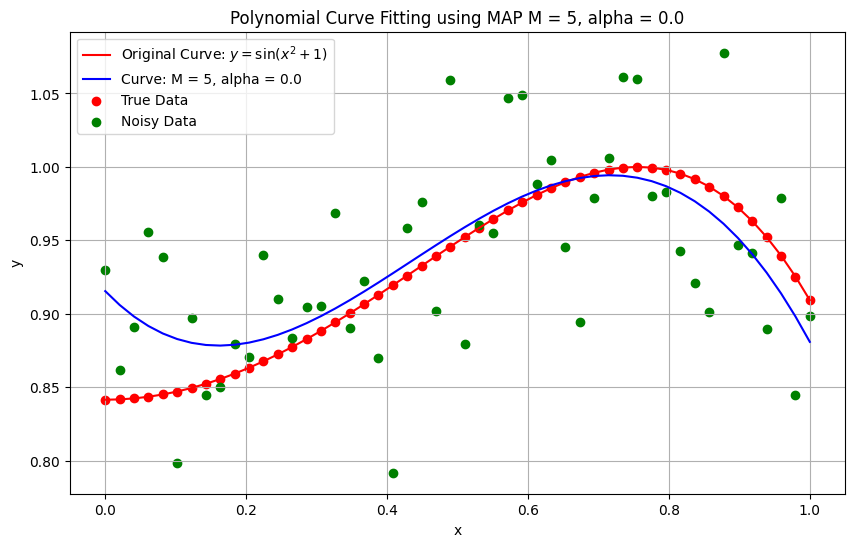

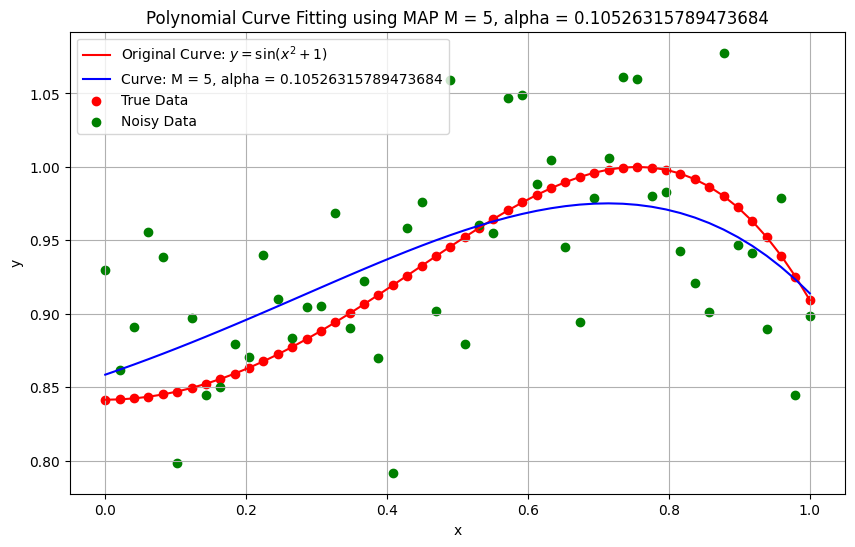

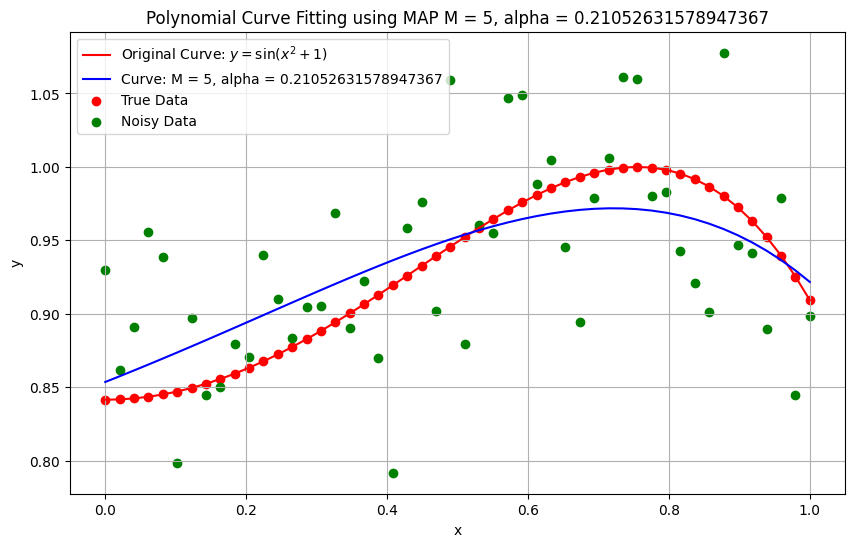

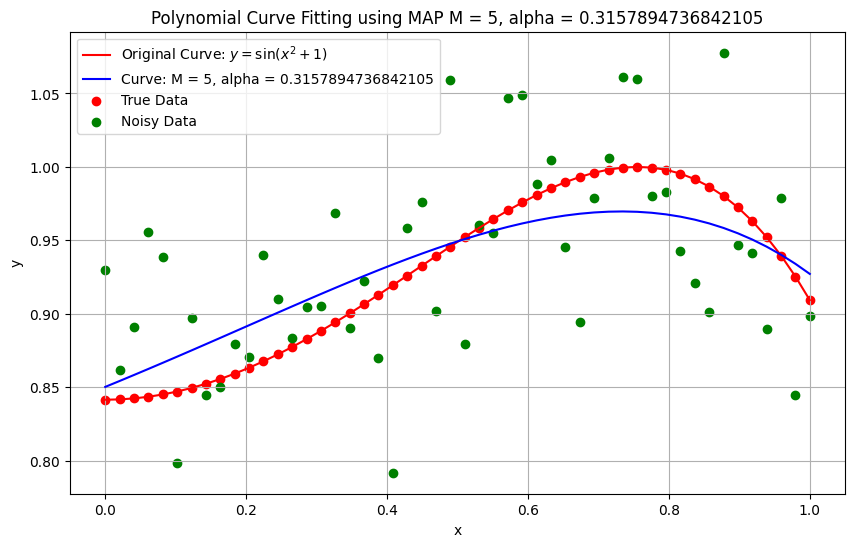

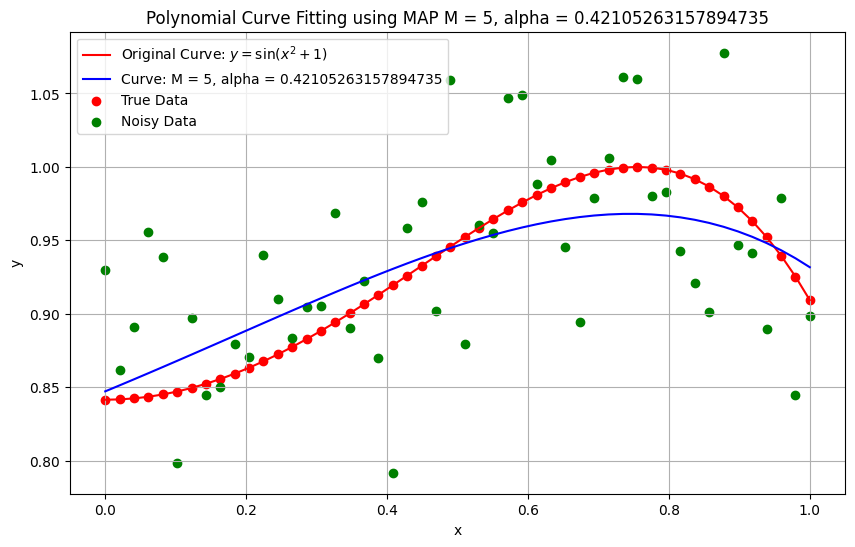

...

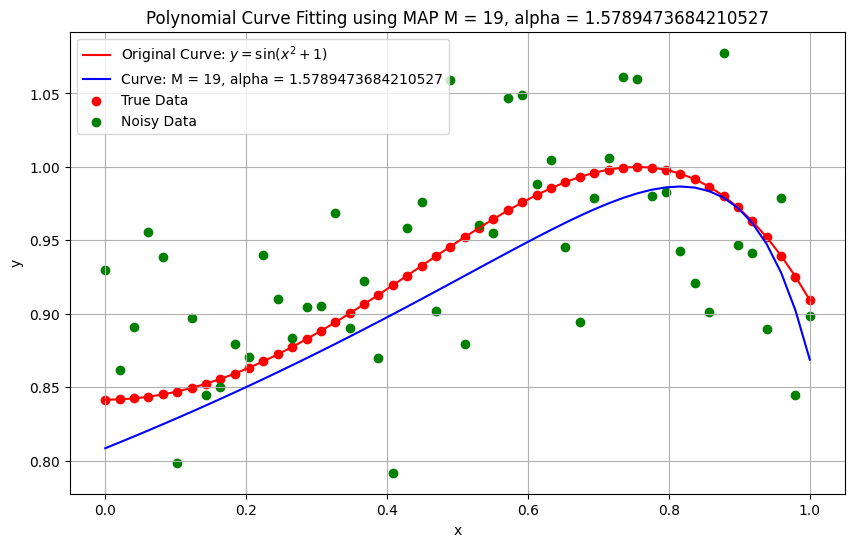

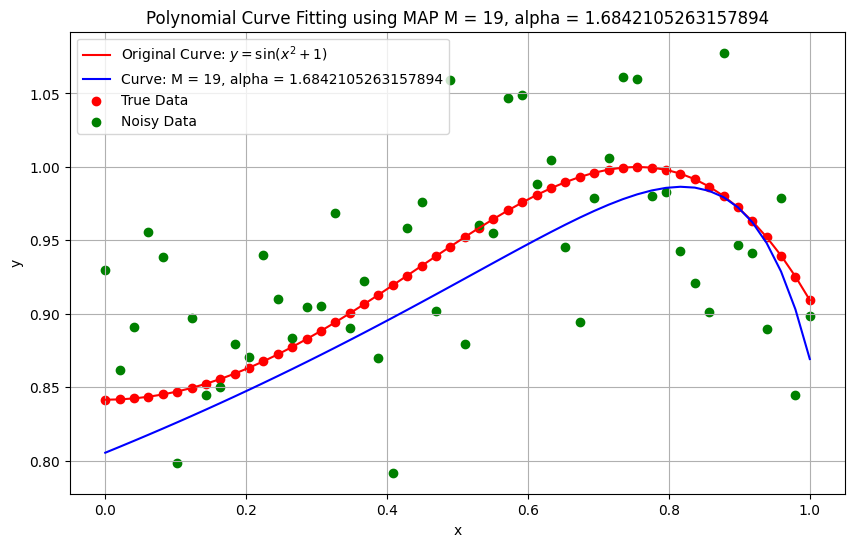

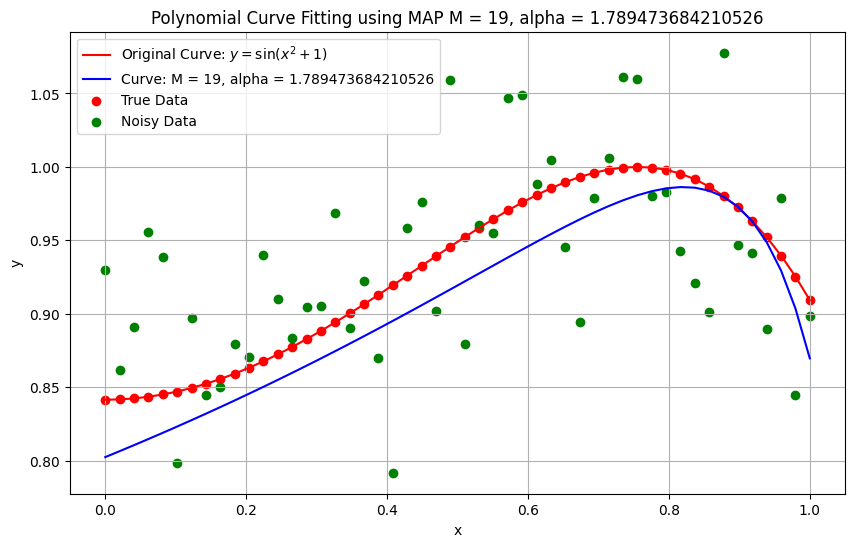

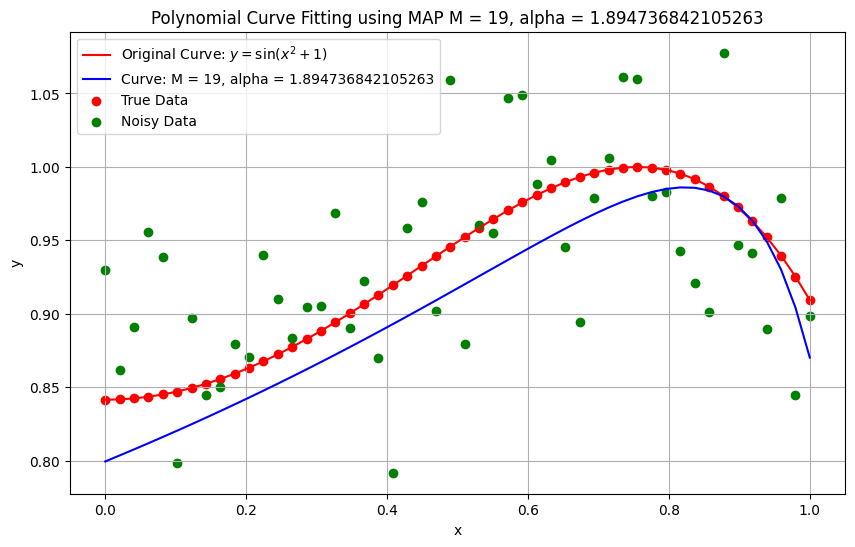

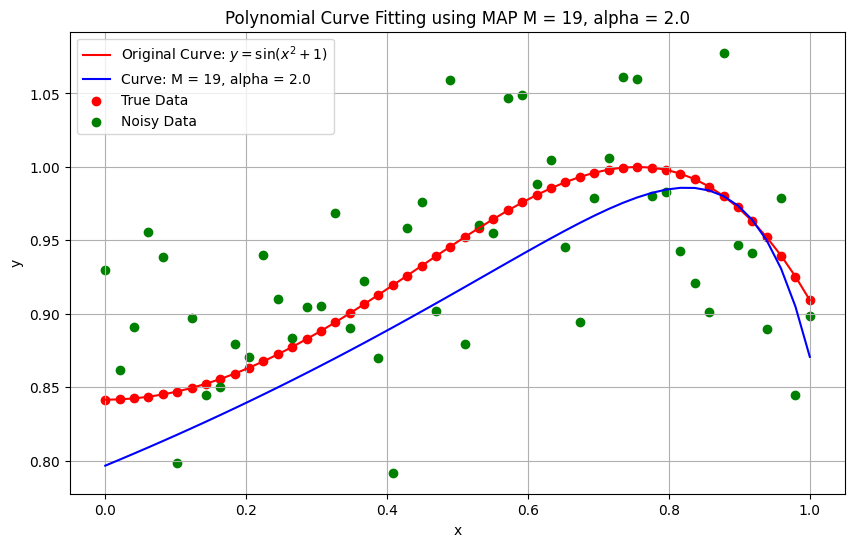

[0.8573487925486923, 1.0251974552333567, 1.0019882693082627, 0.9669922104405233, 0.934667512901393, 0.9030098427913935, 0.8747491403337908, 0.8589551250905291, 0.8519223062793357, 0.8547713156184313, 0.8689487963885253, 0.8958135253967778, 0.9415487213626261, 1.0159652505997436, 1.1146893646539657, 1.2121196014885762, 1.3083102388067203, 1.403309401484767, 1.4971602782721822, 1.5899020312814751, 0.8624600500699414, 0.9467171768146874, 0.90318123646324, 0.8529062080371178, 0.8072601037968747, 0.7685587589439113, 0.7374780697571561, 0.7197082009638278, 0.7125855495957163, 0.7167205362050219, 0.7347444339105489, 0.7694760679722813, 0.8252372782732673, 0.9150627569953279, 1.011466153425651, 1.106824323923322, 1.2011715251157706, 1.2946282383065217, 1.3886511720711863, 1.4816828731057075, 0.856249537749812, 0.9009759035436415, 0.8555287421071585, 0.7990274607631257, 0.7428832668571307, 0.68971310826332, 0.6483054653729531, 0.6230488975412714, 0.6126822658502517, 0.6168534593997712, 0.637147

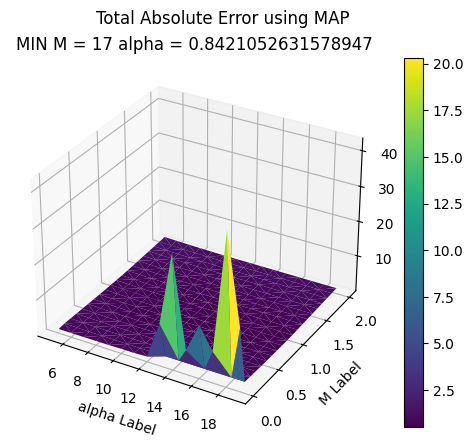

[0.509060369176662, 17, 0.8421052631578947]


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D


#0 random reproducibility

np.random.seed(0)  # for reproducibility


#1. Generate 50 2D-data points using the following function

x = np.linspace(0, 1, 50)
#print(x, x.shape)
y_true = np.sin(np.square(x) + 1)
#print(y_true, y_true.shape)


#2. Add Gaussian random noise to the data

noise = np.random.normal(0, 0.05, y_true.shape)
#print(noise, noise.shape)

y_noisy = y_true + noise
#print(y_noisy, y_noisy.shape)

#3. Show the original curve line and the noisy data

plt.figure(figsize=(10, 6))
plt.plot(x, y_true, 'r-', label='Original Curve: $y = \sin(x^2 + 1)$')
plt.scatter(x, y_true, color='r', marker='o', label='True Data')
plt.scatter(x, y_noisy, color='g', marker='o', label='Noisy Data')
plt.title('Desired Curve and Noisy Data')
plt.legend()
plt.grid(True)
plt.show()


#4. Fit the generated noisy data using the MAP as discussed in class.

def polynomial_curve_fitting(x, t, M, alpha):
    """
    Polynomial curve fitting using MAP
    """

    N = len(x)

    # Design matrix XX
    XX = np.vander(x, M, increasing=True)
    #print('XX =', XX.shape)

    # Regularization term a/bI
    regularization = alpha * np.eye(M)
    #print('regularization =', regularization.shape)

    # Calculate weights
    w = np.linalg.inv(XX.T @ XX + regularization) @ XX.T @ t
    #print('w = ', w.shape)

    return w


def predict(x, w):
    """
    Predict y values for given x values using polynomial weights
    """

    A = np.vander(x, len(w), increasing=True)
    return A @ w


def plotplot(x, y_true, y_pred, y_noisy, M, alpha):
    """
    plot the Polynomial Curve Fitting result
    """
    plt.figure(figsize=(10, 6))
    plt.plot(x, y_true, 'r-', label='Original Curve: $y = \sin(x^2 + 1)$')
    plt.plot(x, y_pred, 'b-', label= f'Curve: M = {M}, alpha = {alpha}')
    plt.scatter(x, y_true, color='r', marker='o', label='True Data')
    #plt.scatter(x, y_pred, color='b', marker='o', label='Predict Data')
    plt.scatter(x, y_noisy, color='g', marker='o', label='Noisy Data')
    plt.title(f'Polynomial Curve Fitting using MAP M = {M}, alpha = {alpha}')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.legend()
    plt.grid(True)
    plt.show()

M = 5  # Degree of the polynomial
alpha = 0.1  # Regularization parameter
w = polynomial_curve_fitting(x, y_noisy, M, alpha)
y_pred = predict(x, w)

plotplot(x, y_true, y_pred, y_noisy, M, alpha)

#5. Compute and display the total absolute error value (between the predicted
#   and the correct ones) of using the computed w.

def total_absolute_error(y_pred, y_true):
    """
    calculate the total absolute error walue
    (between the predicted and the correct ones)
    """
    total_abs_error = 0.0
    for pred, true in zip(y_pred, y_true):
        abs_error = abs(pred - true)
        total_abs_error += abs_error
    return total_abs_error

print('total absolute error value = ', total_absolute_error(y_pred, y_true))

#6. Display the estimated values of w

print(' w = ', w, '\n', 'M = ', M, 'alpha = ', alpha)


#7. Experiment with your code by changing M and alpha (the coefficient of the
#   regularization/prior term) to various values, and then show the plots. On
#   each the plot, you must show the values of M and alpha.

alpha_7 = np.linspace(0,2,20)
tae = 0.0
d_tae = {}
tae_list = []
M_list = []
alpha_list = []

for M in range(5,20):
    for i in range(len(alpha_7)):
        alpha = alpha_7[i]
        #print(alpha)
        w = polynomial_curve_fitting(x, y_noisy, M, alpha)
        y_pred = predict(x, w)
        tae = total_absolute_error(y_pred, y_true)
        tae_list.append(tae)
        M_list.append(M)
        alpha_list.append(alpha)
        d_tae[tae] = [tae, M, alpha]
        plotplot(x, y_true, y_pred, y_noisy, M, alpha)


print(tae_list)
print(d_tae)

#8. From the experiment in #7, discuss how M and alpha influence on the
#   fitting accuracy.

def bubble_sort(arr):
    """
    bubble sort calculation error is minimal
    """
    n = len(arr)

    for i in range(n):
        swapped = False

        for j in range(0, n - i - 1):
            if arr[j] > arr[j + 1]:
                arr[j], arr[j + 1] = arr[j + 1], arr[j]
                swapped = True

        if not swapped:
            break



tae_list_sort = tae_list.copy()
bubble_sort(tae_list_sort)

alpha_list = np.array(alpha_list)
M_list = np.array(M_list)
tae_list = np.array(tae_list)

#plot 3D figure
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
surf = ax.plot_trisurf(M_list, alpha_list, tae_list, cmap='viridis')
ax.set_xlabel('M')
ax.set_ylabel('alpha')
ax.set_zlabel('tae')
plt.suptitle(f'Total Absolute Error using MAP')
plt.title(f'MIN M = {d_tae[tae_list_sort[0]][1]} alpha = {d_tae[tae_list_sort[0]][2]}')
fig.colorbar(surf)
plt.show()



print(d_tae[tae_list_sort[0]])





